# Information in reletive abundace index

In [24]:

function convert_harvest(B,H)
    Fmax = 0.9
    Smin = -log(1 - Fmax)

    
    if B > H
        s = [-log((B-H)/B), Smin]
        S = s[argmin(s)]
    else
        S = Smin
    end 
    H = B*(1-exp(-S))
    return H, B*exp(-S)
end 

function Bt(x,Ht,d)

    B = exp(x[1] + x[2])
    Binfty = exp(x[2])
    r= exp(x[3])

    H,B=convert_harvest(B, Ht)
    
    Bprime = r*B- (r-1)*B^2/Binfty

    if Bprime <0
        Bprime = 1.0
    end 
    
    return [log(Bprime)+rand(d) - x[2], x[2],x[3]]
    
    
end 

Bt (generic function with 1 method)

In [25]:
using Plots
using Distributions 

r_hat = log(1.4)
r_var = 0.025
Binfty_hat = log(100)
Binfty_var = 0.15
V = 0.005
d = Distributions.Normal(-0.5*V,V)


B_hat = log(1.0)
B_var = 0.05

Nsamples = 50000
dx0 = Distributions.MvNormal([B_hat, Binfty_hat, r_hat], [B_var 0 0; 0 Binfty_var 0; 0 0 r_var])
x0_samples = broadcast(i->rand(dx0),1:Nsamples)
x0 = [B_hat,Binfty_hat,r_hat]

Ht = 5

obs = [1.0 0.0 0]
obs_var = 0.005
d_obs = Distributions.Normal(0,obs_var)

function weight(x,y)
    pdf(d_obs,(obs*x)[1]-y)
end 


weight (generic function with 1 method)

In [26]:
function update_samples(x,samples,Ht)
    # state update
    xt = Bt(x,Ht,d)
    xt_samples = broadcast(x0->Bt(x0,Ht, d), samples)
    
    # system update
    yt = (obs *xt)[1] + rand(d_obs)
    weights = broadcast(x->weight(x,yt),xt_samples)
    xt_samples = wsample(xt_samples,weights,Nsamples, replace = true)
    return xt, yt, xt_samples
end 


x = x0
samples=x0_samples
Ht = vcat(collect(1:10),repeat([10],10))
#Ht = vcat(collect(0:0.7:7.0),repeat([7],10))
#Ht = vcat(collect(1:0.5:5.5),repeat([5],10))
Ht = repeat([5.0],20)
   
for i in 1:10
    x,y,samples=update_samples(x,samples,Ht[i])
end 

p1=Plots.scatter(exp.(broadcast( i->samples[i][1],1:Nsamples)),exp.(broadcast( i->samples[i][2],1:Nsamples)))
 
p2=Plots.scatter(broadcast( i->samples[i][2],1:Nsamples),broadcast( i->samples[i][3],1:Nsamples))
    
p3=Plots.scatter(exp.(broadcast( i->samples[i][1],1:Nsamples)),exp.(broadcast( i->samples[i][3],1:Nsamples)))
    
   
plot(p1,p2,p3)

In [27]:
using DataFrames, GLM
function lm_(x,y)
    data = DataFrame(X=x, Y=y)
    ols = GLM.lm(@formula(Y ~ X), data)
end 
lm_(broadcast( i->samples[i][2],1:Nsamples),broadcast( i->samples[i][3],1:Nsamples))

StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, LinearAlgebra.CholeskyPivoted{Float64, Matrix{Float64}}}}, Matrix{Float64}}

Y ~ 1 + X

Coefficients:
─────────────────────────────────────────────────────────────────────────────
                 Coef.   Std. Error         t  Pr(>|t|)  Lower 95%  Upper 95%
─────────────────────────────────────────────────────────────────────────────
(Intercept)   1.35965   0.000896378   1516.83    <1e-99   1.35789    1.36141
X            -0.220817  0.000195991  -1126.67    <1e-99  -0.221201  -0.220433
─────────────────────────────────────────────────────────────────────────────

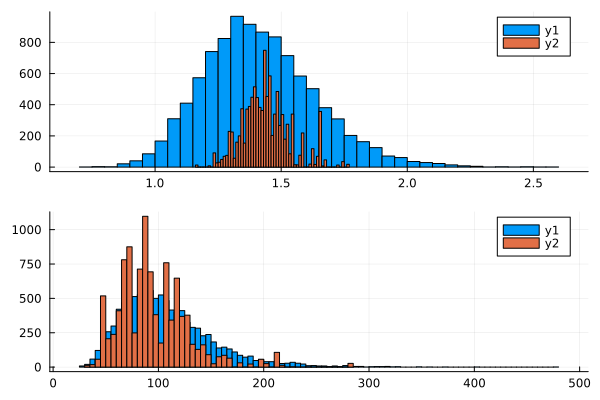

In [38]:
p1=Plots.histogram(exp.(broadcast( i->x0_samples[i][3],1:Nsamples)))
Plots.histogram!(exp.(broadcast( i->samples[i][3],1:Nsamples)))

p2=Plots.histogram(exp.(broadcast( i->x0_samples[i][2],1:Nsamples)))
Plots.histogram!(exp.(broadcast( i->samples[i][2],1:Nsamples)))
plot(p1,p2,layout=(2,1))

# Correlation between r and K

slope: -0.26
intercept: 4.87


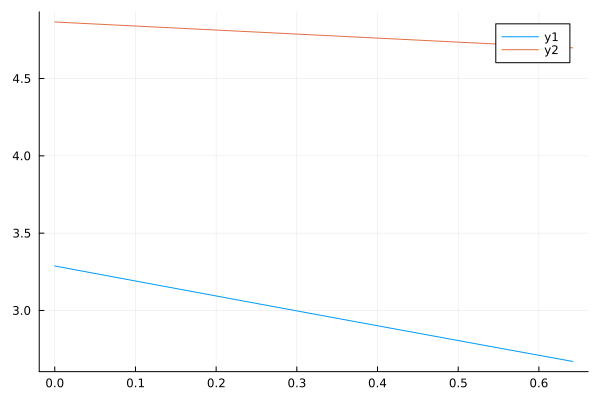

In [392]:
H = 10
x = 0.3
r = 1.4
K = 100
xprime = r*x- (r-1)*x^2 - H/K
logK = log.(1.0:0.01:1.9)
logr = log.(xprime .+ H*exp.(-logK)) .- log(r*x-(r-1)*x^2)
Plots.plot(logK,logr)

# derivitive
lnK = log(K)
lnr = log(r)
dlnrdlnK = -H*exp(-lnK)/(xprime + H*exp(-lnK)) #- (1-2*x)/(x*(1-x))
intercept =  lnK - dlnrdlnK 
println("slope: ", round(dlnrdlnK,digits = 2) )
println("intercept: ", round(intercept,digits = 2) )
Plots.plot!(logK,intercept .+ dlnrdlnK*logK)

slope: -0.286
intercept: 1.652
k: 100.0


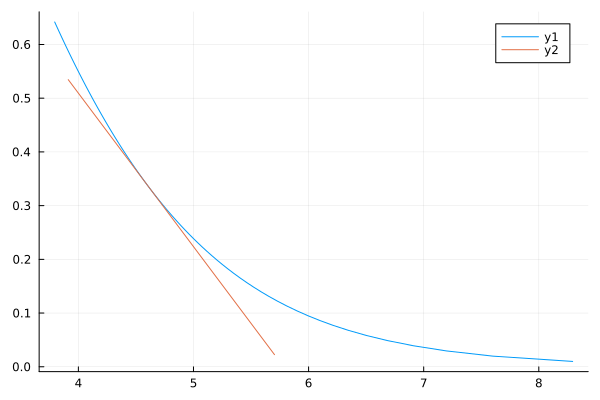

In [22]:
using Plots
r = 1.01:0.01:1.9
r_ = 1.4
MSY = 10
k = MSY/(0.25*(r_-1))

lnK = log(MSY) .- log.(r .-1) .- log(0.25)
Plots.plot(lnK, log.(r))
dlnrdlnK = -(r_ - 1)/r_
logK = log.(50.0:0.01:300)
intercept =  log(r_) -dlnrdlnK *log(k)
println("slope: ", round(dlnrdlnK,digits = 3) )
println("intercept: ", round(intercept,digits = 3) )
println("k: ", round(k,digits = 3)  )
Plots.plot!(logK,intercept .+ dlnrdlnK*logK)

In [ ]:
r/

# Correlated r and K

In [550]:
function Bt_corr(x,Ht,d)

    B = exp(x[1])
    Binfty = exp(x[2])
    r= exp(1.43-0.24*x[2]) #1.427-0.2383*x[2]

    H,B=convert_harvest(B, Ht)
    
    Bprime = r*B- (r-1)*B^2/Binfty

    if Bprime <0
        Bprime = 1.0
    end 
    
    return [log(Bprime)+rand(d), x[2]]
    
end 

Binfty_hat = log(100)
Binfty_var = 0.05
V = 0.05
d = Distributions.Normal(-0.5*V,V)


B_hat = log(100)
B_var = 0.1

Nsamples = 50000
dx0 = Distributions.MvNormal([B_hat, Binfty_hat], [B_var 0 ; 0 Binfty_var ])
x0_samples = broadcast(i->rand(dx0),1:Nsamples)
x0 = [B_hat,Binfty_hat]

Ht = 5

obs = [1.0 -1.0]
obs_var = 0.1
d_obs = Distributions.Normal(0,obs_var)

function weight(x,y)
    pdf(d_obs,(obs*x)[1]-y)
end 

weight (generic function with 1 method)

In [551]:
function update_samples_corr(x,samples,Ht)
    # state update
    xt = Bt_corr(x,Ht,d)
    xt_samples = broadcast(x0->Bt_corr(x0,Ht, d), samples)
    
    # system update
    yt = (obs *xt)[1] + rand(d_obs)
    weights = broadcast(x->weight(x,yt),xt_samples)
    xt_samples = wsample(xt_samples,weights,Nsamples, replace = true)
    return xt, yt, xt_samples
end 


x = x0
samples=x0_samples


Ht = repeat([10.0],20)
for i in 1:10
    x,y,samples=update_samples_corr(x,samples,Ht[i])
end 

p1=Plots.scatter(exp.(broadcast( i->samples[i][1],1:Nsamples)),exp.(broadcast( i->samples[i][2],1:Nsamples)))
p2 = Plots.histogram(broadcast( i->x0_samples[i][2],1:Nsamples))
Plots.histogram!(broadcast( i->samples[i][2],1:Nsamples))
p3 = Plots.histogram(exp.(broadcast( i->samples[i][1],1:Nsamples)))
p4 = Plots.histogram(exp.(broadcast( i->1.43-0.24*x0_samples[i][2],1:Nsamples)),xlabel="")
Plots.histogram!(exp.(broadcast( i->1.43-0.24*samples[i][2],1:Nsamples)),xlabel="")
plot(p1,p2,p3,p4)

# Simulate kalman filer 

In [99]:
include("state_and_params.jl")
include("../src/BeliefStateTransitions.jl")

Main.BeliefStateTransitions

In [281]:


T = (x,actions,aux) -> state_and_params.Bt(x,actions,state_and_params.pars)
SigmaN = [0.05 0.0; 0.0 0.0001]


# Set grid for harvest rates and monitoring levels
harvest = collect(0.0:2.5:25)
function SigmaO(H,x)
    return 0.01
end 

R=(x,action,aux) -> state_and_params.R(x,action,0,0.00,0.0,100,state_and_params.pars)
# define model object to compute grid 
model=BeliefStateTransitions.init_model(T,x->1,state_and_params.H,harvest,SigmaO,SigmaN,2) 

Main.BeliefStateTransitions.model([0.0, 0.0], [0.0 0.0; 0.0 0.0], [0.0, 2.5, 5.0, 7.5, 10.0, 12.5, 15.0, 17.5, 20.0, 22.5, 25.0], [0.0], [0.0;;], var"#581#582"(), var"#585#586"(), 0.0, [1.0 0.0], SigmaO, [0.05 0.0; 0.0 0.0001], 2)

In [282]:
quad=BeliefStateTransitions.init_QuadQuad(6,6,2,1,2)
print(" ")

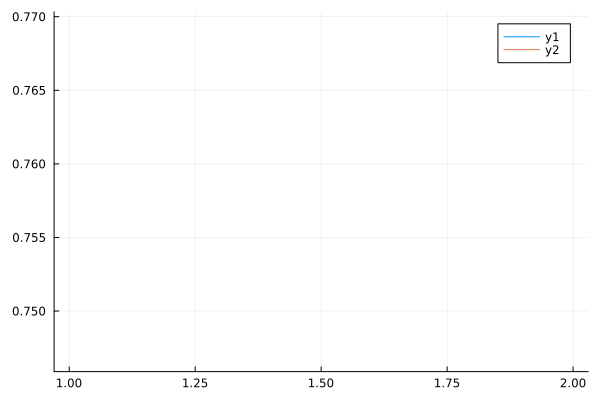

In [284]:
include("../src/MvGaussHermite.jl")
x = log.([0.5,100])
s = [x0, [0.05 0.0; 0.0 0.15]]
q = MvGaussHermite.init_mutable(6,s[1],s[2])
T = 1
acc_x = zeros(T)
acc_s = zeros(T)
for t in 1:T
    x,s,y=BeliefStateTransitions.simulate!(x,s,0.0,model,q)
    acc_s[t] = exp.(s[1][1])
    acc_x[t] = exp.(x[1])
end

Plots.plot(acc_x)
Plots.plot!(acc_s)

[1.0 -0.05736761218040483; -0.05736761218040483 1.0]


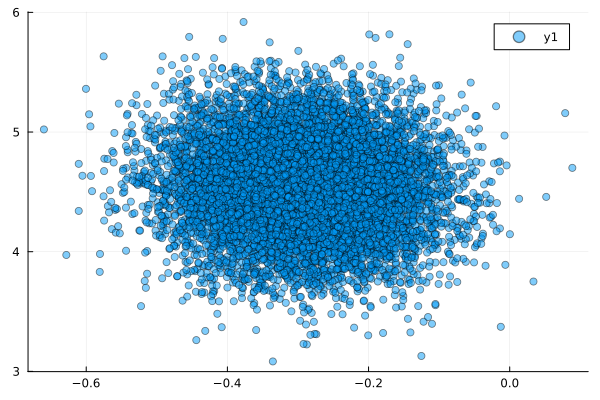

In [285]:
s_dsn = Distributions.MvNormal(s[1],s[2])
println(Distributions.cor(s_dsn))
Nsamples = 10000
s_samples = rand(s_dsn,Nsamples)
Plots.scatter(broadcast(i->s_samples[1,i],1:Nsamples),broadcast(i->s_samples[2,i],1:Nsamples),alpha = 0.5)

In [ ]:
#include("../src/ValueFunctions.jl")
include("../src/MDPsolver.jl")
V = MDPsolver.ValueFunctions.init_guasianBeleifsInterp2d(10, [log(0.01),0],log.([1.5,250]), [0.1,0.2], [-0.25,0.25])
print(" ")

In [170]:
include("../src/BeliefStateTransitions.jl")
transitions = BeliefStateTransitions.init_Transitions(model,V,R;mQuad=6)
print(" ")

In [ ]:
BeliefStateTransitions.compute_Transitions!(transitions)

In [ ]:
BeliefStateTransitions.computeRewards!(transitions)
sum(transitions.rewards)

In [ ]:
include("../src/MDPsolver.jl")
MDPsolver.solve_parallel(transitions,V,0.91)

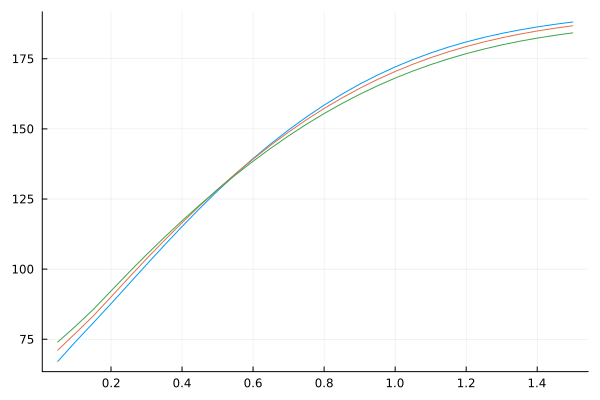

In [182]:

using Plots
cor = 0.5
Binfty = 150
var = sqrt(0.1*0.25)
Plots.plot(0.05:0.05:1.5,broadcast(x ->V(zeros(5),([log(x),log(Binfty) ],[0.01 0.05*var;0.05*var 0.01])),0.05:0.05:1.5))
Plots.plot!(0.05:0.05:1.5,broadcast(x ->V(zeros(5),([log(x),log(Binfty)],[0.05 0.05*var;0.05*var 0.05])),0.05:0.05:1.5))
Plots.plot!(0.05:0.05:1.5,broadcast(x ->V(zeros(5),([log(x),log(Binfty)],[0.1 0.05*var;0.05*var 0.1])),0.05:0.05:1.5),
legend = false)



In [177]:
ind = (49*25 - 7)
println(exp.(V.nodes[ind][1]))
println(V.nodes[ind][2])

[0.9115318743488066, 1.3510764005615499]
[0.014644660940672622 7.77664245852374e-5; 7.77664245852374e-5 0.010899347581163212]


-9.104295426143786e6